# Automated Image Classification of Paellas with InceptionResNetV2

Author: Ramón Albert

Date: 24 de Abril, 2023

This work presents the development of a multi-class neural network classification, which aims to identify and categorize various typical Valencian dishes, such as paella, arroz a banda, arroz al horno, and fideuà. It also includes a class capable of identifying paellas that do not follow the traditional recipe.
<table>
  <tr> 
    <td style="text-align:justify">
        <b>Paella</b><br>
        <img src="https://imag.bonviveur.com/paella-valenciana-tradicional.jpg" alt="Paella" width="300"/><br>
        .
    </td>
    <td style="text-align:justify">
        <b>Rice with Stuff</b><br>
        <img src="https://casualfoodist.com/wp-content/uploads/2021/09/Chicken-and-Chorizo-Paella-2.jpg" alt="Rice with Stuff" width="300"/><br>
        .
    </td>
  </tr>
</table>

This project uses the InceptionResNetV2 pre-trained model to build a neural network that predicts whether an image of a Valencian dish is a paella or not. 

The neural network has been implemented using Python and Keras, and the final model achieved an accuracy of 93% on the test set.

The model has been integrated into an Instagram bot that automatically likes paella posts.
</table>


In [7]:
#Importing some librariess
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

## GPU Verification

In [8]:
from tensorflow.config import list_physical_devices as isgpu

if isgpu('GPU'):
    print(" available GPU 🚀 ")
else:
    print(" not available GPU 🐢 ")

 available GPU 🚀 


## Data

For the training of the neural network, a dataset has been created for the classification of paellas.

This dataset is divided into 6 different classes:

    Arroz a banda
    Fideuà
    Rice with things
    Paella
    Unknown
    Arroz al horno

In [9]:
from PIL import Image
data_dir = "clasificacion/PaellaPorClases/"
total_img=0
## Showing the number of images from dataset 
class_counts = {}
for class_name in os.listdir(data_dir):
    class_dir = os.path.join(data_dir, class_name)
    if os.path.isdir(class_dir):
        image_list = [f for f in os.listdir(class_dir) if os.path.isfile(os.path.join(class_dir, f))]    
        print("{} contains  {} images.".format(class_name, len(image_list)))        
    total_img+=len(image_list)
print("In total, there are {} images.".format(total_img))

Arroz_con_cosas contains  748 images.
Arròs_al_forn contains  750 images.
Arròs_a_banda contains  749 images.
Desconocido contains  797 images.
Fideuà contains  749 images.
Paella contains  749 images.
In total, there are 4542 images.


In [10]:
batch_size = 16
epochs =100
img_width, img_height = 299, 299

## Data split

Data is divided with the following proportion:

- 70% Train
- 20% Validation
- 10% Test

In [11]:
data_dir_path = "clasificacion/PaellaPorClases/"

In [15]:
from sklearn.model_selection import train_test_split

def create_dataframe(data_dir):
    
    filepaths = []
    classes = []
    
    for class_name in os.listdir(data_dir):
        class_dir = os.path.join(data_dir, class_name)
        if os.path.isdir(class_dir):
            for filename in os.listdir(class_dir):
                filepath = os.path.join(class_dir, filename)
                filepaths.append(filepath)
                classes.append(class_name)
    
    df = pd.DataFrame({'filepath': filepaths, 'label': classes})
    
    return df

In [54]:
def split_data(data_dir):
    df = create_dataframe(data_dir)


    train_df, test_df = train_test_split(df, test_size=0.1, random_state=1234)


    train_df, val_df = train_test_split(train_df, test_size=0.2, random_state=1234)

    return train_df, val_df, test_df

In [55]:
df_train, df_val, df_test=split_data(data_dir_path)
df_train.head()

,filepath,label
479,clasificacion/PaellaPorClases/Arroz_con_cosas\...,Arroz_con_cosas
2789,clasificacion/PaellaPorClases/Desconocido\543_...,Desconocido
4060,clasificacion/PaellaPorClases/Paella\268_20230...,Paella
3718,clasificacion/PaellaPorClases/Fideuà\675_20230...,Fideuà
51,clasificacion/PaellaPorClases/Arroz_con_cosas\...,Arroz_con_cosas


# Data generators configuration

To train a neural network with images of paellas, the "ImageDataGenerator" module from the "Keras" library has been used.

Since the dataset has a relatively small number of data, the data augmentation technique has been used to increase the number of images for training the network. This way, we create more variability in the data.

In [56]:
from PIL import ImageOps
from keras.preprocessing.image import ImageDataGenerator


train_datagen = ImageDataGenerator(
        rescale=1./255,
        shear_range=0.2,
        zoom_range=0.2,
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        channel_shift_range=0.4,  
        brightness_range=[0.8, 1.2],
        horizontal_flip=True,
        vertical_flip=False,
        fill_mode='constant')
      

validation_datagen = ImageDataGenerator(rescale=1./255)

test_datagen = ImageDataGenerator(rescale=1./255)


print("Train:")
train_generator = train_datagen.flow_from_dataframe(
        df_train,
        x_col='filepath',
        y_col='label',
        target_size=(img_width, img_height),
        batch_size=batch_size,
        class_mode='categorical')

print("Validation:")
validation_generator = validation_datagen.flow_from_dataframe(
        df_val,
        x_col='filepath',
        y_col='label',
        target_size=(img_width, img_height),
        batch_size=batch_size,
        class_mode='categorical')

print("Test:")
test_generator = test_datagen.flow_from_dataframe(
        df_test,
        x_col='filepath',
        y_col='label',
        target_size=(img_width, img_height),
        batch_size=batch_size,
        class_mode='categorical')

Train:
Found 3269 validated image filenames belonging to 6 classes.
Validation:
Found 818 validated image filenames belonging to 6 classes.
Test:
Found 455 validated image filenames belonging to 6 classes.


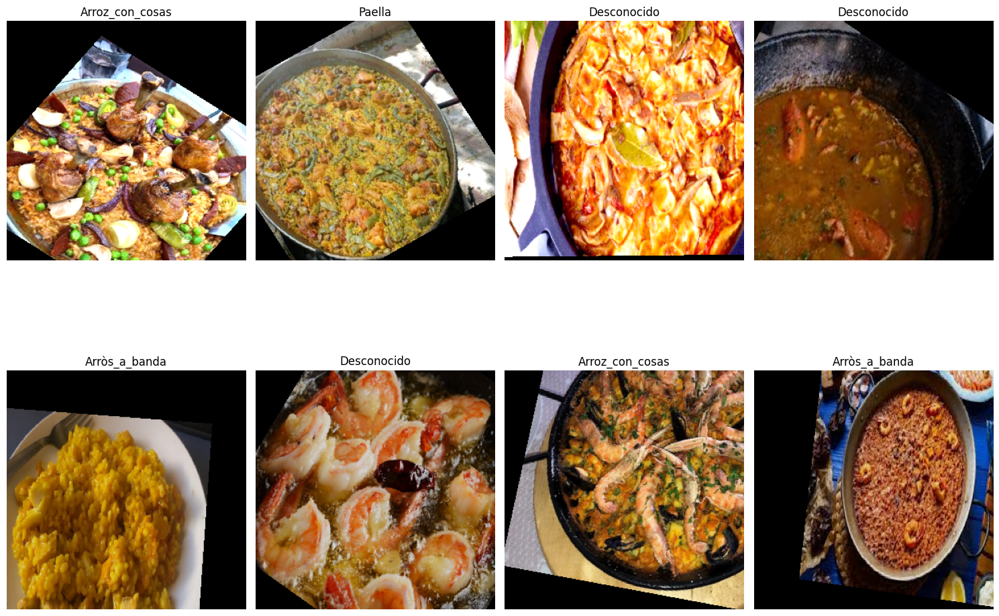

In [53]:
def translate_label(index):
    label_map = train_generator.class_indices
    return [key for key, value in label_map.items() if value == index][0]

images, labels = next(train_generator) # Get the images and labels from the training generator

rows, cols = 2, 4
fig, axes = plt.subplots(rows, cols, figsize=(15, 12)) # Create the figure to show the images
axes = axes.ravel()

for i in range(rows * cols): # Iterate over all the images in the batch
    img = images[i]
    true_label = np.argmax(labels[i])
    img_rgb = img
    title = f"{translate_label(true_label)}" # Add the label name to the image title
    axes[i].imshow(img_rgb)
    axes[i].set_title(title, fontsize=12)
    axes[i].axis('off')

plt.tight_layout()
plt.show()

## Creación del modelo

In [94]:
import tensorflow as tf
from keras.applications.inception_resnet_v2 import InceptionResNetV2
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, BatchNormalization, Flatten
from tensorflow.keras.optimizers import Adam
from keras.regularizers import l2

# Extract the number of existing classes
num_classes = 6

# Load Inception-ResNet-v2
base_model = InceptionResNetV2(weights="imagenet", include_top=False, input_shape=(img_width, img_height, 3))

# Select the number of layers to freeze
freeze_layers = 3
fine_tune_at = len(base_model.layers)

for layer in base_model.layers:
    layer.trainable = False

# Unfreeze the last 3 layers of the base model
for layer in base_model.layers[-freeze_layers:]:
    if hasattr(layer, 'kernel_regularizer'):
        layer.kernel_regularizer = l2(0.05)
    layer.trainable = True

# Add layers for class classification
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)  #0.5
predictions = Dense(num_classes, activation='softmax')(x)

# Define the model
model = Model(inputs=base_model.input, outputs=predictions)
model.summary()



Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_10 (InputLayer)          [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_1827 (Conv2D)           (None, 149, 149, 32  864         ['input_10[0][0]']               
                                )                                                                 
                                                                                                  
 batch_normalization_1836 (Batc  (None, 149, 149, 32  96         ['conv2d_1827[0][0]']            
 hNormalization)                )                                                           

                                                                                                  
 conv2d_1834 (Conv2D)           (None, 35, 35, 64)   76800       ['activation_1833[0][0]']        
                                                                                                  
 conv2d_1837 (Conv2D)           (None, 35, 35, 96)   82944       ['activation_1836[0][0]']        
                                                                                                  
 conv2d_1838 (Conv2D)           (None, 35, 35, 64)   12288       ['average_pooling2d_9[0][0]']    
                                                                                                  
 batch_normalization_1841 (Batc  (None, 35, 35, 96)  288         ['conv2d_1832[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 batch_nor

                                                                                                  
 block35_1_mixed (Concatenate)  (None, 35, 35, 128)  0           ['activation_1839[0][0]',        
                                                                  'activation_1841[0][0]',        
                                                                  'activation_1844[0][0]']        
                                                                                                  
 block35_1_conv (Conv2D)        (None, 35, 35, 320)  41280       ['block35_1_mixed[0][0]']        
                                                                                                  
 block35_1 (Lambda)             (None, 35, 35, 320)  0           ['mixed_5b[0][0]',               
                                                                  'block35_1_conv[0][0]']         
                                                                                                  
 block35_1

 batch_normalization_1861 (Batc  (None, 35, 35, 32)  96          ['conv2d_1852[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 batch_normalization_1864 (Batc  (None, 35, 35, 48)  144         ['conv2d_1855[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_1852 (Activation)   (None, 35, 35, 32)   0           ['batch_normalization_1861[0][0]'
                                                                 ]                                
                                                                                                  
 activation_1855 (Activation)   (None, 35, 35, 48)   0           ['batch_normalization_1864[0][0]'
          

 batch_normalization_1871 (Batc  (None, 35, 35, 64)  192         ['conv2d_1862[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_1857 (Activation)   (None, 35, 35, 32)   0           ['batch_normalization_1866[0][0]'
                                                                 ]                                
                                                                                                  
 activation_1859 (Activation)   (None, 35, 35, 32)   0           ['batch_normalization_1868[0][0]'
                                                                 ]                                
                                                                                                  
 activation_1862 (Activation)   (None, 35, 35, 64)   0           ['batch_normalization_1871[0][0]'
          

                                                                                                  
 batch_normalization_1881 (Batc  (None, 35, 35, 32)  96          ['conv2d_1872[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_1872 (Activation)   (None, 35, 35, 32)   0           ['batch_normalization_1881[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_1870 (Conv2D)           (None, 35, 35, 32)   10240       ['block35_5_ac[0][0]']           
                                                                                                  
 conv2d_1873 (Conv2D)           (None, 35, 35, 48)   13824       ['activation_1872[0][0]']        
          

                                                                                                  
 conv2d_1877 (Conv2D)           (None, 35, 35, 32)   9216        ['activation_1876[0][0]']        
                                                                                                  
 conv2d_1880 (Conv2D)           (None, 35, 35, 64)   27648       ['activation_1879[0][0]']        
                                                                                                  
 batch_normalization_1884 (Batc  (None, 35, 35, 32)  96          ['conv2d_1875[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 batch_normalization_1886 (Batc  (None, 35, 35, 32)  96          ['conv2d_1877[0][0]']            
 hNormalization)                                                                                  
          

                                                                  'activation_1883[0][0]',        
                                                                  'activation_1886[0][0]']        
                                                                                                  
 block35_8_conv (Conv2D)        (None, 35, 35, 320)  41280       ['block35_8_mixed[0][0]']        
                                                                                                  
 block35_8 (Lambda)             (None, 35, 35, 320)  0           ['block35_7_ac[0][0]',           
                                                                  'block35_8_conv[0][0]']         
                                                                                                  
 block35_8_ac (Activation)      (None, 35, 35, 320)  0           ['block35_8[0][0]']              
                                                                                                  
 conv2d_18

                                                                                                  
 batch_normalization_1906 (Batc  (None, 35, 35, 48)  144         ['conv2d_1897[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_1894 (Activation)   (None, 35, 35, 32)   0           ['batch_normalization_1903[0][0]'
                                                                 ]                                
                                                                                                  
 activation_1897 (Activation)   (None, 35, 35, 48)   0           ['batch_normalization_1906[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_18

                                                                                                  
 conv2d_1904 (Conv2D)           (None, 17, 17, 128)  139264      ['mixed_6a[0][0]']               
                                                                                                  
 batch_normalization_1913 (Batc  (None, 17, 17, 128)  384        ['conv2d_1904[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_1904 (Activation)   (None, 17, 17, 128)  0           ['batch_normalization_1913[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_1905 (Conv2D)           (None, 17, 17, 160)  143360      ['activation_1904[0][0]']        
          

 block17_2 (Lambda)             (None, 17, 17, 1088  0           ['block17_1_ac[0][0]',           
                                )                                 'block17_2_conv[0][0]']         
                                                                                                  
 block17_2_ac (Activation)      (None, 17, 17, 1088  0           ['block17_2[0][0]']              
                                )                                                                 
                                                                                                  
 conv2d_1912 (Conv2D)           (None, 17, 17, 128)  139264      ['block17_2_ac[0][0]']           
                                                                                                  
 batch_normalization_1921 (Batc  (None, 17, 17, 128)  384        ['conv2d_1912[0][0]']            
 hNormalization)                                                                                  
          

                                                                  'activation_1918[0][0]']        
                                                                                                  
 block17_4_conv (Conv2D)        (None, 17, 17, 1088  418880      ['block17_4_mixed[0][0]']        
                                )                                                                 
                                                                                                  
 block17_4 (Lambda)             (None, 17, 17, 1088  0           ['block17_3_ac[0][0]',           
                                )                                 'block17_4_conv[0][0]']         
                                                                                                  
 block17_4_ac (Activation)      (None, 17, 17, 1088  0           ['block17_4[0][0]']              
                                )                                                                 
          

                                                                                                  
 activation_1926 (Activation)   (None, 17, 17, 192)  0           ['batch_normalization_1935[0][0]'
                                                                 ]                                
                                                                                                  
 block17_6_mixed (Concatenate)  (None, 17, 17, 384)  0           ['activation_1923[0][0]',        
                                                                  'activation_1926[0][0]']        
                                                                                                  
 block17_6_conv (Conv2D)        (None, 17, 17, 1088  418880      ['block17_6_mixed[0][0]']        
                                )                                                                 
                                                                                                  
 block17_6

 batch_normalization_1943 (Batc  (None, 17, 17, 192)  576        ['conv2d_1934[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_1931 (Activation)   (None, 17, 17, 192)  0           ['batch_normalization_1940[0][0]'
                                                                 ]                                
                                                                                                  
 activation_1934 (Activation)   (None, 17, 17, 192)  0           ['batch_normalization_1943[0][0]'
                                                                 ]                                
                                                                                                  
 block17_8_mixed (Concatenate)  (None, 17, 17, 384)  0           ['activation_1931[0][0]',        
          

 conv2d_1942 (Conv2D)           (None, 17, 17, 192)  215040      ['activation_1941[0][0]']        
                                                                                                  
 batch_normalization_1948 (Batc  (None, 17, 17, 192)  576        ['conv2d_1939[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 batch_normalization_1951 (Batc  (None, 17, 17, 192)  576        ['conv2d_1942[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_1939 (Activation)   (None, 17, 17, 192)  0           ['batch_normalization_1948[0][0]'
                                                                 ]                                
          

 activation_1949 (Activation)   (None, 17, 17, 160)  0           ['batch_normalization_1958[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_1947 (Conv2D)           (None, 17, 17, 192)  208896      ['block17_11_ac[0][0]']          
                                                                                                  
 conv2d_1950 (Conv2D)           (None, 17, 17, 192)  215040      ['activation_1949[0][0]']        
                                                                                                  
 batch_normalization_1956 (Batc  (None, 17, 17, 192)  576        ['conv2d_1947[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 batch_nor

 conv2d_1957 (Conv2D)           (None, 17, 17, 160)  143360      ['activation_1956[0][0]']        
                                                                                                  
 batch_normalization_1966 (Batc  (None, 17, 17, 160)  480        ['conv2d_1957[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_1957 (Activation)   (None, 17, 17, 160)  0           ['batch_normalization_1966[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_1955 (Conv2D)           (None, 17, 17, 192)  208896      ['block17_13_ac[0][0]']          
                                                                                                  
 conv2d_19

 hNormalization)                                                                                  
                                                                                                  
 activation_1964 (Activation)   (None, 17, 17, 128)  0           ['batch_normalization_1973[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_1965 (Conv2D)           (None, 17, 17, 160)  143360      ['activation_1964[0][0]']        
                                                                                                  
 batch_normalization_1974 (Batc  (None, 17, 17, 160)  480        ['conv2d_1965[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activatio

                                )                                                                 
                                                                                                  
 conv2d_1972 (Conv2D)           (None, 17, 17, 128)  139264      ['block17_17_ac[0][0]']          
                                                                                                  
 batch_normalization_1981 (Batc  (None, 17, 17, 128)  384        ['conv2d_1972[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_1972 (Activation)   (None, 17, 17, 128)  0           ['batch_normalization_1981[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_19

                                                                                                  
 block17_19 (Lambda)            (None, 17, 17, 1088  0           ['block17_18_ac[0][0]',          
                                )                                 'block17_19_conv[0][0]']        
                                                                                                  
 block17_19_ac (Activation)     (None, 17, 17, 1088  0           ['block17_19[0][0]']             
                                )                                                                 
                                                                                                  
 conv2d_1980 (Conv2D)           (None, 17, 17, 128)  139264      ['block17_19_ac[0][0]']          
                                                                                                  
 batch_normalization_1989 (Batc  (None, 17, 17, 128)  384        ['conv2d_1980[0][0]']            
 hNormaliz

 conv2d_1984 (Conv2D)           (None, 8, 8, 384)    884736      ['activation_1983[0][0]']        
                                                                                                  
 conv2d_1986 (Conv2D)           (None, 8, 8, 288)    663552      ['activation_1985[0][0]']        
                                                                                                  
 conv2d_1989 (Conv2D)           (None, 8, 8, 320)    829440      ['activation_1988[0][0]']        
                                                                                                  
 batch_normalization_1993 (Batc  (None, 8, 8, 384)   1152        ['conv2d_1984[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 batch_normalization_1995 (Batc  (None, 8, 8, 288)   864         ['conv2d_1986[0][0]']            
 hNormaliz

                                                                                                  
 batch_normalization_2005 (Batc  (None, 8, 8, 224)   672         ['conv2d_1996[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_1996 (Activation)   (None, 8, 8, 224)    0           ['batch_normalization_2005[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_1994 (Conv2D)           (None, 8, 8, 192)    399360      ['block8_1_ac[0][0]']            
                                                                                                  
 conv2d_1997 (Conv2D)           (None, 8, 8, 256)    172032      ['activation_1996[0][0]']        
          

 conv2d_2004 (Conv2D)           (None, 8, 8, 224)    129024      ['activation_2003[0][0]']        
                                                                                                  
 batch_normalization_2013 (Batc  (None, 8, 8, 224)   672         ['conv2d_2004[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_2004 (Activation)   (None, 8, 8, 224)    0           ['batch_normalization_2013[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_2002 (Conv2D)           (None, 8, 8, 192)    399360      ['block8_3_ac[0][0]']            
                                                                                                  
 conv2d_20

                                                                                                  
 conv2d_2012 (Conv2D)           (None, 8, 8, 224)    129024      ['activation_2011[0][0]']        
                                                                                                  
 batch_normalization_2021 (Batc  (None, 8, 8, 224)   672         ['conv2d_2012[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_2012 (Activation)   (None, 8, 8, 224)    0           ['batch_normalization_2021[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_2010 (Conv2D)           (None, 8, 8, 192)    399360      ['block8_5_ac[0][0]']            
          

                                                                 ]                                
                                                                                                  
 conv2d_2020 (Conv2D)           (None, 8, 8, 224)    129024      ['activation_2019[0][0]']        
                                                                                                  
 batch_normalization_2029 (Batc  (None, 8, 8, 224)   672         ['conv2d_2020[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_2020 (Activation)   (None, 8, 8, 224)    0           ['batch_normalization_2029[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_20

 activation_2027 (Activation)   (None, 8, 8, 192)    0           ['batch_normalization_2036[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_2028 (Conv2D)           (None, 8, 8, 224)    129024      ['activation_2027[0][0]']        
                                                                                                  
 batch_normalization_2037 (Batc  (None, 8, 8, 224)   672         ['conv2d_2028[0][0]']            
 hNormalization)                                                                                  
                                                                                                  
 activation_2028 (Activation)   (None, 8, 8, 224)    0           ['batch_normalization_2037[0][0]'
                                                                 ]                                
          

## Entrenamiento

In [95]:
#Callbacks

import json
from keras.callbacks import Callback,ReduceLROnPlateau,ModelCheckpoint

#Define a callback to track and record the model's performance metrics throughout training.

class MetricsHistory(Callback):
    def on_train_begin(self, logs=None):

        self.loss_history = []
        self.val_loss_history = []
        self.accuracy_history = [] 
        self.val_accuracy_history = []

    def on_epoch_end(self, epoch, logs=None):
        self.loss_history.append(logs['loss'])
        self.val_loss_history.append(logs['val_loss'])
        self.accuracy_history.append(logs['categorical_accuracy']) 
        self.val_accuracy_history.append(logs['val_categorical_accuracy']) 
        
#Define a callback to reduce the learning rate if the validation loss plateaus.    
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=10, verbose=1, min_lr=1e-9)
#Define a callback to save the best model based on validation accuracy. 
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_categorical_accuracy', mode='max', save_best_only=True, verbose=1)

#Instantiate the metrics history callback.
metrics_history=MetricsHistory()


In [96]:
# Model Compilation
model.compile(optimizer=Adam(learning_rate=1e-5), loss='categorical_crossentropy', metrics=['categorical_accuracy'])
callbacks = [reduce_lr, model_checkpoint,metrics_history]

In [97]:
# Training
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.n // batch_size,
    epochs=epochs,
    validation_data=validation_generator,
    validation_steps=validation_generator.n // batch_size,
    shuffle=True,
    callbacks=callbacks)

Epoch 1/100
204/204 [==============================] - ETA: 0s - loss: 1.8644 - categorical_accuracy: 0.3990
Epoch 1: val_categorical_accuracy improved from -inf to 0.68260, saving model to best_model.h5
204/204 [==============================] - 157s 705ms/step - loss: 1.8644 - categorical_accuracy: 0.3990 - val_loss: 1.0099 - val_categorical_accuracy: 0.6826 - lr: 1.0000e-05
Epoch 2/100
204/204 [==============================] - ETA: 0s - loss: 1.1987 - categorical_accuracy: 0.6028
Epoch 2: val_categorical_accuracy improved from 0.68260 to 0.76716, saving model to best_model.h5
204/204 [==============================] - 132s 644ms/step - loss: 1.1987 - categorical_accuracy: 0.6028 - val_loss: 0.6866 - val_categorical_accuracy: 0.7672 - lr: 1.0000e-05
Epoch 3/100
204/204 [==============================] - ETA: 0s - loss: 0.9667 - categorical_accuracy: 0.6861
Epoch 3: val_categorical_accuracy improved from 0.76716 to 0.80025, saving model to best_model.h5
204/204 [=====================

Epoch 23/100
204/204 [==============================] - ETA: 0s - loss: 0.4128 - categorical_accuracy: 0.8611
Epoch 23: val_categorical_accuracy improved from 0.89828 to 0.89951, saving model to best_model.h5
204/204 [==============================] - 151s 740ms/step - loss: 0.4128 - categorical_accuracy: 0.8611 - val_loss: 0.3238 - val_categorical_accuracy: 0.8995 - lr: 1.0000e-05
Epoch 24/100
204/204 [==============================] - ETA: 0s - loss: 0.4469 - categorical_accuracy: 0.8445
Epoch 24: val_categorical_accuracy did not improve from 0.89951
204/204 [==============================] - 151s 741ms/step - loss: 0.4469 - categorical_accuracy: 0.8445 - val_loss: 0.3287 - val_categorical_accuracy: 0.8922 - lr: 1.0000e-05
Epoch 25/100
204/204 [==============================] - ETA: 0s - loss: 0.4006 - categorical_accuracy: 0.8641
Epoch 25: val_categorical_accuracy improved from 0.89951 to 0.90074, saving model to best_model.h5
204/204 [==============================] - 149s 732ms/st

Epoch 46/100
204/204 [==============================] - ETA: 0s - loss: 0.2899 - categorical_accuracy: 0.9026
Epoch 46: val_categorical_accuracy did not improve from 0.90931
204/204 [==============================] - 147s 717ms/step - loss: 0.2899 - categorical_accuracy: 0.9026 - val_loss: 0.2852 - val_categorical_accuracy: 0.9032 - lr: 1.0000e-05
Epoch 47/100
204/204 [==============================] - ETA: 0s - loss: 0.2967 - categorical_accuracy: 0.8992
Epoch 47: val_categorical_accuracy did not improve from 0.90931
204/204 [==============================] - 151s 740ms/step - loss: 0.2967 - categorical_accuracy: 0.8992 - val_loss: 0.2826 - val_categorical_accuracy: 0.9093 - lr: 1.0000e-05
Epoch 48/100
204/204 [==============================] - ETA: 0s - loss: 0.2794 - categorical_accuracy: 0.9038
Epoch 48: val_categorical_accuracy did not improve from 0.90931
204/204 [==============================] - 150s 736ms/step - loss: 0.2794 - categorical_accuracy: 0.9038 - val_loss: 0.2782 - 

204/204 [==============================] - ETA: 0s - loss: 0.2392 - categorical_accuracy: 0.9139
Epoch 69: val_categorical_accuracy did not improve from 0.91912
204/204 [==============================] - 149s 730ms/step - loss: 0.2392 - categorical_accuracy: 0.9139 - val_loss: 0.2616 - val_categorical_accuracy: 0.9167 - lr: 1.0000e-05
Epoch 70/100
204/204 [==============================] - ETA: 0s - loss: 0.2260 - categorical_accuracy: 0.9216
Epoch 70: val_categorical_accuracy improved from 0.91912 to 0.92157, saving model to best_model.h5
204/204 [==============================] - 151s 740ms/step - loss: 0.2260 - categorical_accuracy: 0.9216 - val_loss: 0.2676 - val_categorical_accuracy: 0.9216 - lr: 1.0000e-05
Epoch 71/100
204/204 [==============================] - ETA: 0s - loss: 0.2285 - categorical_accuracy: 0.9216
Epoch 71: val_categorical_accuracy did not improve from 0.92157
204/204 [==============================] - 148s 721ms/step - loss: 0.2285 - categorical_accuracy: 0.9216

Epoch 92/100
204/204 [==============================] - ETA: 0s - loss: 0.2075 - categorical_accuracy: 0.9293
Epoch 92: val_categorical_accuracy did not improve from 0.92157
204/204 [==============================] - 144s 705ms/step - loss: 0.2075 - categorical_accuracy: 0.9293 - val_loss: 0.2671 - val_categorical_accuracy: 0.9179 - lr: 1.0000e-07
Epoch 93/100
204/204 [==============================] - ETA: 0s - loss: 0.2023 - categorical_accuracy: 0.9271
Epoch 93: val_categorical_accuracy did not improve from 0.92157
204/204 [==============================] - 145s 709ms/step - loss: 0.2023 - categorical_accuracy: 0.9271 - val_loss: 0.2685 - val_categorical_accuracy: 0.9167 - lr: 1.0000e-07
Epoch 94/100
204/204 [==============================] - ETA: 0s - loss: 0.2130 - categorical_accuracy: 0.9268
Epoch 94: val_categorical_accuracy did not improve from 0.92157
204/204 [==============================] - 146s 714ms/step - loss: 0.2130 - categorical_accuracy: 0.9268 - val_loss: 0.2703 - 

## Model evaluation

Epoch with minimum validation loss: 65
Epoch with maximum validation accuracy: 70


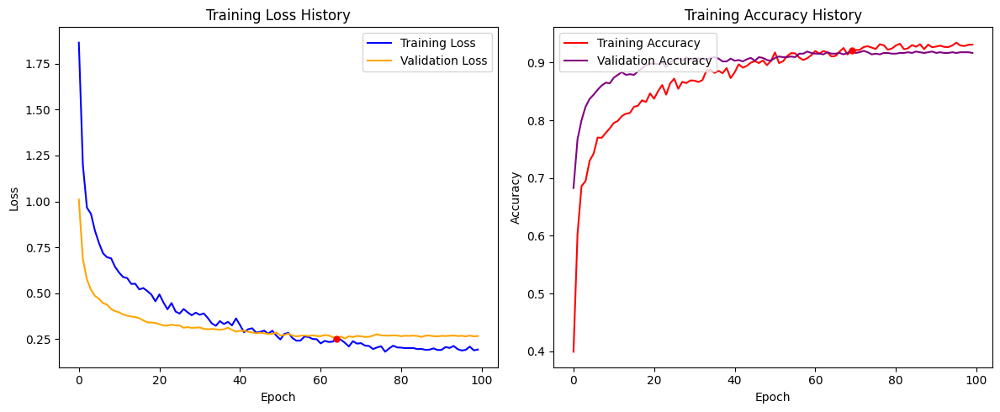

In [98]:
#Loss and Accuracy Plots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
#Plot loss history

ax1.plot(metrics_history.loss_history, label='Training Loss', color='blue')
ax1.plot(metrics_history.val_loss_history, label='Validation Loss', color='orange')

ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss')
ax1.legend(loc='upper right')
ax1.set_title('Training Loss History')
#Plot accuracy history

ax2.plot(metrics_history.accuracy_history, label='Training Accuracy', color='red')
ax2.plot(metrics_history.val_accuracy_history, label='Validation Accuracy', color='purple')
ax2.set_xlabel('Epoch')
ax2.set_ylabel('Accuracy')
ax2.legend(loc='upper left')
ax2.set_title('Training Accuracy History')
#Get index of minimum validation loss and maximum validation accuracy

min_val_loss_idx = np.argmin(metrics_history.val_loss_history)
max_val_acc_idx = np.argmax(metrics_history.val_accuracy_history)
#Show red point on the minimum values

ax1.plot(min_val_loss_idx, metrics_history.val_loss_history[min_val_loss_idx], marker='o', markersize=5, color='red')
ax2.plot(max_val_acc_idx, metrics_history.val_accuracy_history[max_val_acc_idx], marker='o', markersize=5, color='red')
#Print epoch number where the minimum validation loss and maximum validation accuracy were reached

print(f"Epoch with minimum validation loss: {min_val_loss_idx+1}") 
print(f"Epoch with maximum validation accuracy: {max_val_acc_idx+1}")

fig.tight_layout()
plt.show()

In [99]:
#Load best model
from tensorflow.keras.models import load_model   
model = load_model('best_model.h5')

In [100]:
#Reset the test generator to start from the beginning
test_generator.reset()

#Evaluate the model on the test set and obtain the loss and accuracy
loss, accuracy = model.evaluate(test_generator, steps=test_generator.n // batch_size)

28/28 [==============================] - 14s 292ms/step - loss: 41.0680 - categorical_accuracy: 0.9129


In [101]:
import matplotlib.patches as patches

def translate_label(label):
    labels = ["Rice with stuff","Arroz a banda", "Arroz al horno", "Unknown", "Fideuà", "Paella"]
    return labels[label]


fig, axes = plt.subplots(16, 4, figsize=(48, 228))
axes = axes.ravel()

for j in range(4):
    images, labels = next(test_generator)
    predictions = model.predict(images)
    predicted_labels = np.argmax(predictions, axis=1)

    for i in range(16):
        index = i + j*16
        img = images[i]
        true_label = np.argmax(labels[i])
        predicted_label = predicted_labels[i]
        prediction = predictions[i]

        img_rgb = img * (255.0)
        img_rgb = img_rgb.astype('uint8')

        predicted_prob = np.max(prediction)
        title = "Prediction: {} ({:.2f}%)\nReal: {}".format(translate_label(predicted_label), predicted_prob*100, translate_label(true_label))

        axes[index].imshow(img_rgb)
        axes[index].set_title(title, fontsize=50, color='green' if true_label == predicted_label else 'red')
        axes[index].axis('off')

        rect = patches.Rectangle((0, 0), img_rgb.shape[1] - 1, img_rgb.shape[0] - 1, linewidth=40,
                                  edgecolor='green' if true_label == predicted_label else 'red', facecolor='none')
        axes[index].add_patch(rect)


plt.tight_layout()
plt.savefig('fig.png')
plt.show()


1/1 [==============================] - 0s 99ms/step


<Figure size 640x480 with 0 Axes>

1/1 [==============================] - 0s 72ms/step


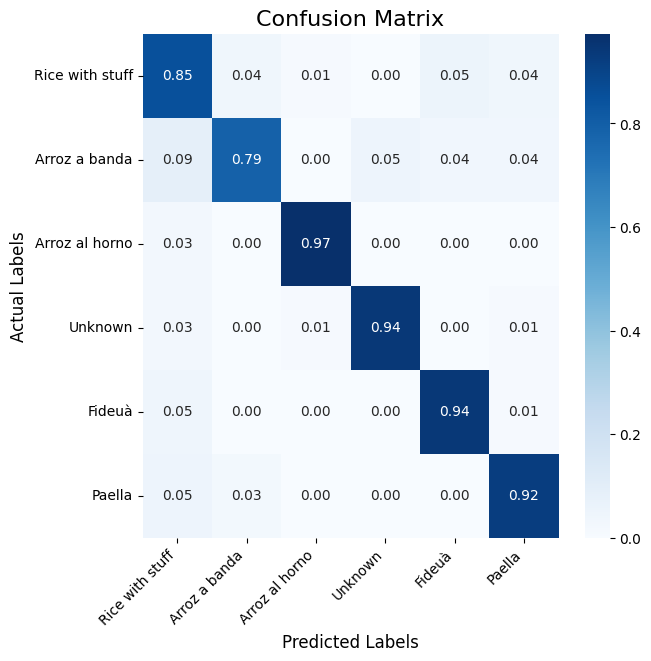

In [82]:
# Import the library to calculate the confusion matrix and the library to create the confusion matrix plot
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Calculate the number of batches in the test set
num_batches = test_generator.n // batch_size

# Get the actual labels and predictions for multiple batches
all_labels = []
all_predictions = []
for i in range(num_batches): # num_batches is the total number of batches you want to process
    images, labels = next(test_generator)
    predictions = model.predict(images)
    all_labels.append(labels)
    all_predictions.append(predictions)

# Concatenate all actual labels and predictions
all_labels = np.concatenate(all_labels)
all_predictions = np.concatenate(all_predictions)

# Calculate the confusion matrix
cm = confusion_matrix(np.argmax(all_labels, axis=1), np.argmax(all_predictions, axis=1))

# Normalize the confusion matrix
cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# Create a confusion matrix plot
fig, ax = plt.subplots(figsize=(8, 8))
sns.heatmap(cm_norm, annot=True, cmap='Blues', fmt='.2f', ax=ax)
ax.set_xlabel('Predicted Labels', fontsize=12)
ax.set_ylabel('Actual Labels', fontsize=12,)
ax.set_title('Confusion Matrix', fontsize=16)

# Translate label names
labels = ["Rice with things","Rice with seafood", "Baked rice", "Unknown", "Fideuà", "Paella"]
tick_labels = [translate_label(i) for i in range(len(labels))]
ax.set_xticklabels(tick_labels, fontsize=10, rotation=45, ha='right')
ax.set_yticklabels(tick_labels, fontsize=10, rotation=360)

# Adjust spacing so that titles do not overlap with labels
plt.subplots_adjust(left=0.25, bottom=0.25)

# Show the plot
plt.show()

## Grad-cam



In [65]:
def find_ind_last_conv2D(model):
    ind_last_conv2D_layer = None
    for i,x in enumerate(model.layers):
        if x.__class__.__name__ == "Conv2D":
            ind_last_conv2D_layer = i
    return ind_last_conv2D_layer

In [73]:
import cv2
from keras import backend as K

def show_heatmap(model, im, heatmap_factor=0.5, cmap=cv2.COLORMAP_HOT):
    imag = np.expand_dims(im, axis=0)
        
    # The is the output feature map of the last convolutional layer
    last_conv_layer = model.layers[find_ind_last_conv2D(model)]
    
    # This is the gradient of the "benign" class with regard to
    # the output feature map of last convolutional layer
    with tf.GradientTape() as tape:
        aux = model.output

        iterate = tf.keras.models.Model([model.inputs], [aux, last_conv_layer.output])
        model_out, last_conv_layer = iterate(imag.copy()) # ***

        class_out = model_out[:, np.argmax(model_out[0])]
        grads = tape.gradient(class_out, last_conv_layer)

        # mean intensity of the gradient over a specific feature map channel:
        pooled_grads = K.mean(grads, axis=(0, 1, 2))
    
    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, last_conv_layer), axis=-1)    
    heatmap = np.maximum(heatmap, 0) # se quitan los negativos (se ponen a 0)
    heatmap /= np.max(heatmap) # se normaliza entre 0 y 1
    heatmap = heatmap[0] # pasamos de 1 conjunto de 1 heatmap a 1 heatmap
    
    img = imag[0]
    
    img = np.zeros((im.shape[0],im.shape[1],3))
    for i in range(3):
        img[:,:,i] = imag[0,:,:,0]

    
    # We resize the heatmap to have the same size as the original image
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    
    # We convert the heatmap to RGB
    heatmap = np.uint8(255 * heatmap)
    
    # We apply the heatmap to the original image
    heatmap = cv2.applyColorMap(heatmap, cmap) / 255
    
    im2 = (im - im.min()) / (im.max() - im.min())
    superimposed_img = (1-heatmap_factor)*im2 + heatmap_factor*heatmap

    return heatmap, superimposed_img
 

1/1 [==============================] - 0s 93ms/step


<function matplotlib.pyplot.show(close=None, block=None)>

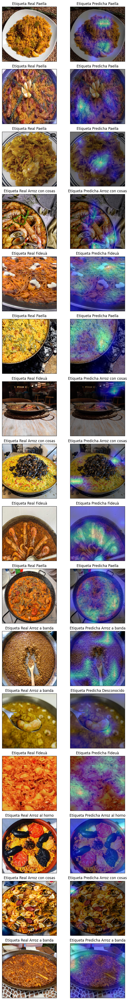

In [99]:
images, labels = next(test_generator)
predictions = model.predict(images)

# Create a figure to display the images and heatmaps
fig, axs = plt.subplots(nrows=len(images), ncols=2, figsize=(8,48))
fig.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, wspace=0.1, hspace=0.3)

# Loop over all images in the generator and display the heatmaps
for i, im in enumerate(images):
    # Show the original image in the first column
    axs[i, 0].imshow(im)
    axs[i, 0].set_xticks([])
    axs[i, 0].set_yticks([])
    axs[i, 0].set_title(f"Actual Label {translate_label(np.argmax(labels[i]))}")

    # Show the heatmap in the second column
    heatmap, superimposed_img = show_heatmap(model, im)
    axs[i, 1].imshow(superimposed_img)
    axs[i, 1].set_xticks([])
    axs[i, 1].set_yticks([])
    axs[i, 1].set_title(f"Predicted Label {translate_label(np.argmax(predictions[i]))}")

# Show the figure
plt.tight_layout()
plt.show()

## Instagram bot

In [35]:
# Function to preprocess images
def imagepreprocess(img):
    
    img_array = np.array(img)

    # Resize the image to 299x299 pixels
    img = Image.fromarray(img_array)
    img = img.resize((299, 299))

    # Normalize the pixel values from 0 to 255 to 0 to 1
    img_array = (1.0 / 255) * np.array(img)

    return img_array

In [86]:
from instagrapi import Client
import urllib.request
import matplotlib.pyplot as plt
import time

downloaded_posts_file = "downloaded_posts.txt"
Read the password from the text file

with open("password.txt", "r") as f:
password = f.readline().strip()
#Initializes the Instagram client using the password read from the text file

client = Client()
client.login("paellainspector", password)"

True

Una paella deliciosa, acompañada de un excelente servicio y atención...

¿Que más se puede pedir? ❤️

Nos encanta ofrecerles siempre una atención  de calidad con una gran sonrisa y mucho cariño

#islademargarita #margaritagastronomica #margarita_ve #paella #buenservicio #buenaatencion #excelentecalidad #buenrestaurant #porlamar #pampatar
1/1 [==============================] - 0s 79ms/step
('Arroz con cosas', 0.98155254)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


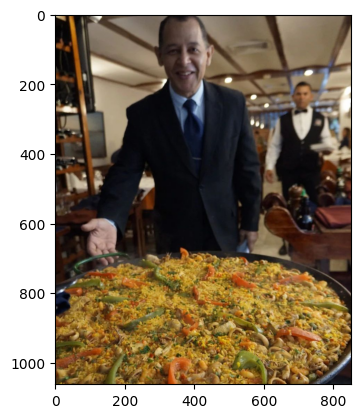

牡蠣と浅利のフライパンパエリア🥘
簡単美味😚

#paella #パエリア #パエジャ #フライパン #フライパンパエリア #パエリア鍋 #牡蠣のパエリア #牡蠣 #カキ #オイスター #oysters #oyster #自炊 #料理 #男の料理 #料理男子 #グルメ #food #foodie #cook #cooking #eat #delicious #gourmet #美味しい #美味 #パプリカ #paprika #あさり #サフラン
1/1 [==============================] - 0s 53ms/step
('Arroz con cosas', 0.99987245)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


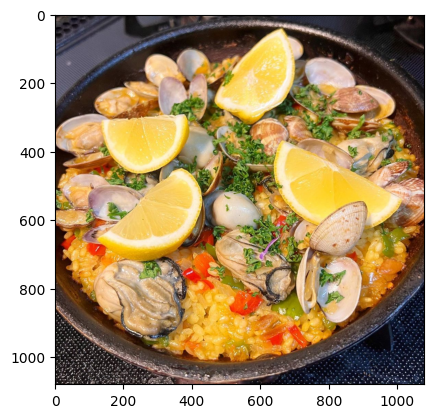

Paella del senyoret 🥘
Seafood paella 🥘 
•
•
•
#food #cook #dishes #foodies #pornfood #cuina #menjar #petitsplaers #handmade  #foodgram #foodielove #foodilife #foodporn #pornfood #instafood #sensefiltres #nofilter #mediterràneament #feed #gastronomia #gastronomy #comfortfood #lovefood #foodlife #chef #cuoco #cucina #paella 🐻👨🏼‍🍳
1/1 [==============================] - 0s 59ms/step
('Arroz a banda', 0.9665468)


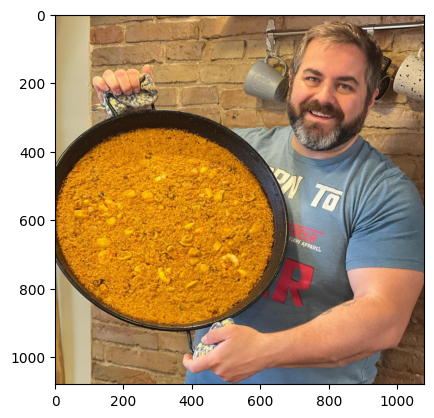

Hamburguesa clásica 🍔🤤 en #elclotrestaurante 🔥
.
.
.
#bcnrestaurant #bcnfoodieguide #bcnfoodguide #foodie #paellas #barcelona #bcnlovers #bcnfoodies #tapasbar #bcnmoltmes #tapasespañolas #bcngourmet #bcn #tapas #foodiesbcn #bcnrestaurantes #paellalovers #barcelonafood #tapasbarcelona #bcnfoodexperience #foodies #paella #foodiegram #barcelonarestaurants #bcnfood #barcelonacity #bcnrestaurants #barcelonafoodies #bcnfoodie
1/1 [==============================] - 0s 74ms/step
('Desconocido', 0.99437535)


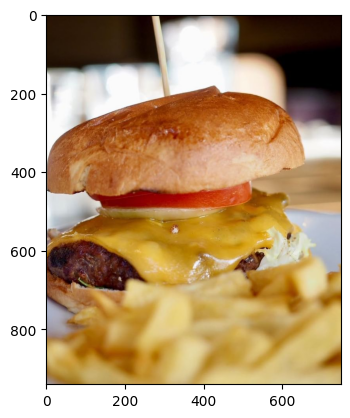

Jamón ibérico cortado a mano 🤤 ¡Perfecto para compartir! En #tapassanmiguel 👏🏻
.
.
.
#bcnfood #bcngourmet #tapasespañolas #bcnmoltmes #gastronomiabcn #bcnrestaurant #barcelona #barcelonafoodies #tapasbar #barcelonafoodie #barcelonaspain #paella #bcnrestaurants #bcnfoodieguide #terrazabar #barriogotico #tapasbarcelona #bcnrestaurantes #paellas #barcelonafoodexperience #bcnfoodies #bcn #barcelonafood #foodies #tapas #barriogoticobarcelona #bcnlovers #bcnfoodie #barcelonacity
1/1 [==============================] - 0s 85ms/step
('Desconocido', 0.90229726)


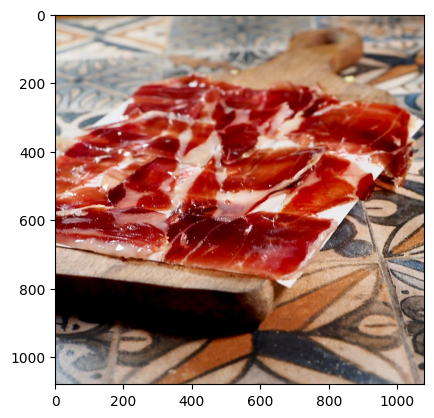

#plat #croquettes #fromage #mozzarella #fritte #riz #paella #courgette #aubergine #delicious #délice #gourmand #gourmandise #recette #recettefacile #recettemaison #recetteramadan #recetterapide #lovefood #foodlovers #kitshen_art🍳🌯 #plat_salé #ramadan #ramadankareem 🌙❤️
1/1 [==============================] - 0s 82ms/step
('Desconocido', 0.9995592)


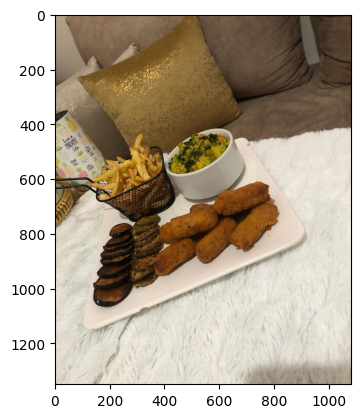

Arroz con ragú, solomillo de pavo y alitas de pollo al horno!!
#onefoodahead #andretraditionalfood #foodporn #arroz #paella #paellas #paella🥘 #socarrat #alitasdepollo
1/1 [==============================] - 0s 78ms/step
('Paella', 0.33791918)
Se ha dado like a la publicación


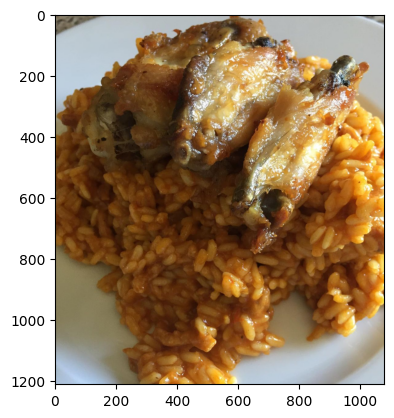

地中海バル　el jardin (エル　アルディン)

スペイン料理🇪🇸パエリア🥘 を中心としたお店です。 

Instagram ¡Síganme todos, por favor!
フォローありがとうございます

スペインワイン🇪🇸にスペインビール🇪🇸

パエリア🥘パーティー

他人との接触を避けた、2Fのプライベートラウンジで飲み放題パーティープランもあります。

 ・庭の緑を見ながらのレストランスペース

 ・2F の貸切ラウンジご予約受付中です

プライベートな集まりに最適なパーティールーム
8名様〜　¥5500/90分〜

みなさまのお越しを楽しみにお待ちしております！

地中海バル　eljardin
052-325-5220

——+——+——+——+——

名古屋市東区東桜2-17-13
052-325-5220

18:00  Open
22:30  ラストオーダー

1F
4人掛けテーブル　× 4席
2人掛けテーブル　× 2席
カウンター ×4席

2F 
貸切　プライベートラウンジ
(専用トイレ、セルフBarカウンター完備)

8名〜18名くらい

90分　¥6,600〜　予約制

国際パエリアコンクール出場
スペイン料理武者修業を経たシェフのお店

#eljardin #地中海バルeljardin 
#パエリア #貸切パーティー 
#プライベートラウンジ 
#新栄デート #新栄女子会 #新栄貸スペース
#新栄誕生日ディナー 
#新栄ディナー #東桜ディナー 
#名古屋グルメ #名古屋パーティー 
#新栄貸切 #東桜貸切　

#新栄グルメ #東桜グルメ　
#新栄スペインバル　#東桜スペインバル
#新栄スペイン料理 #東桜スペイン料理 
#名古屋スペインバル #名古屋スペイン料理 
#新栄ワイン #東桜ワイン 
#東桜バー #新栄飲み
#paella #españa
1/1 [==============================] - 0s 109ms/step
('Desconocido', 0.9874494)


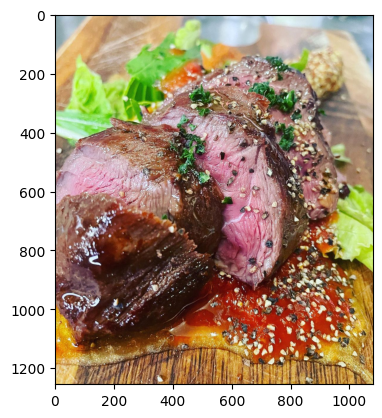

前回1月のハワイ旅行から3ヶ月、今回は用事兼ねてで、ただいまハワイ滞在中ですがゆっくりハワイ投稿を✍️
・
・
今回は関空からハワイへ✈️
・
・
機内食は東京のフレンチレストラン、レフェルヴェソンスの生江シェフ監修メニューかと思ったら、関空発は違ったの😖
・
・
去年11月のハワイの時は羽田から行ったから食べれたけれど、そっちの方が良かったなぁ〜😩
・
・
では、ハワイ投稿しばらく続きます😆
#ハワイ #hawaii #ハワイ旅行 #hawaiitrip #旅行 #travel #海外旅行 #5泊7日 #✈️ #jal #日本航空 #機内食 #🍾 #sparklingwine #スパークリングワイン #🍷 #wine #ワイン #サラダ #salad #paella #パエリア #seafoodpaella #シーフードパエリア #メロンロールケーキ
1/1 [==============================] - 0s 80ms/step
('Desconocido', 0.87406546)


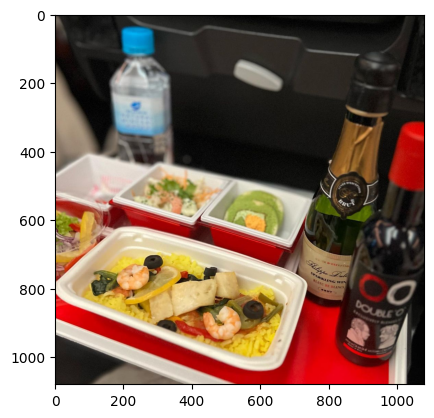

Yummy 😋 Brazilian chicken croquettes 😋

Collected pic 👈

Follow:@foodish_housee 
Follow:@foodish_housee 
.
.
.
.
#croquettes #foodporn #food #croquetas #a #delicious #foodphotography #foodie #takeaway #foodpic #croquette #paella #mozarella #restaurantesdebarcelona #restaurantbarcelona #italianfood #lasmejorescroquetas #detodalavida #bestpizza #gavamar #lapava #polloasado #gava #castelldefels #lapavapizzeria #lapavabraseria #pava #lamejorpizza #hornodele #hechasalale
1/1 [==============================] - 0s 82ms/step
('Desconocido', 0.9999279)


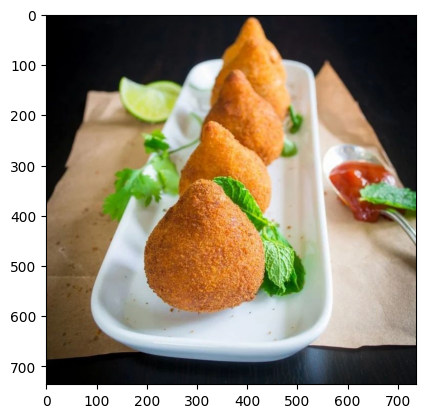

I call it lazy Paella, but really it's just oven baked rice.
.
.
.
#rusticfood #wholesome #tastyfood #realgood #yummy #homecooked #lovefood #worksmart #nothard #cheflife #yachtchef #femalechef #yachtcrew #privatechef #foodie #crewdinner #ovenbaked #riceislife #lazy #paella #spanish #spanishfood #traditional #simple #basic #delicious #feedinganarmy #onepotmeal #allinone #madewithlove
1/1 [==============================] - 0s 73ms/step
('Arroz al horno', 0.8557548)


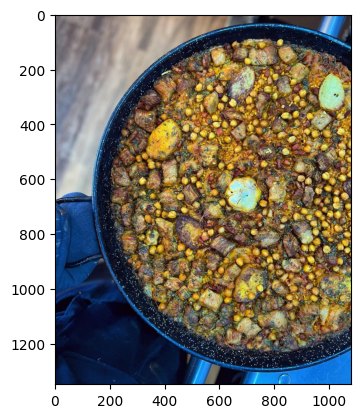

Octopus 🐙 and morcilla paella 🥘
By @_la_rambla__ !!!
A beautiful “mar y montaña” paella for a special guests!
#laramblahk #laramblahongkong #paella #paellalovers #paella🥘 #paellas #spanishfood #spanishfoodporn #hkfoodie #hkfoodblog #hkfoodstagram #hkfoodporn #hkfoodlover #thefinaltable #thefinaltablenetflix #chefsofinstagram #chefslife #chefsroll #chefstable #chefsoninstagram #chefstalk #chefs_eye #chefstagram #chefsteps #chefstyle #chefslife🔪 #chefskills #chefsalert #chefstatus #chefspecial
1/1 [==============================] - 0s 82ms/step
('Arroz con cosas', 0.9980013)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


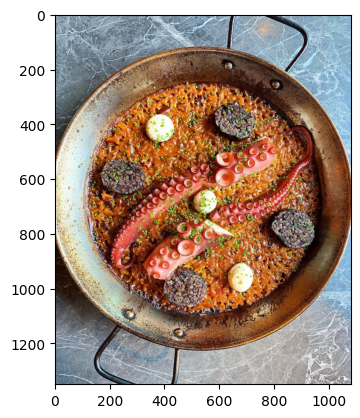

¿Conocés nuestras cazuelas?

Además de ser deliciosas son ideales para compartir, ¿Sabías que tenemos ½ porción que rinde para 2 ó 3 personas, y porción entera que pueden llegar a comer hasta 5? 😱😱 Sí, así como lees.

👉 Ahora tu único problema es elegir cuál vas a pedir 😩

⭐ Cazuela de calamares
⭐ Cazuela de pollo
⭐ Cazuela de pulpo
⭐ Cazuela de mariscos
⭐ Arroz con pollo
⭐ Arroz con calamares
⭐ Arroz con mariscos
⭐ Arroz con langostinos

 Tenés tiempo hasta la noche para decidir, ¡te esperamos! 😋

📍 Estamos en San José 224, Montserrat, CABA.

📢No te quedes sin tu mesa, hace tu reserva llamando al 4381-5215 o por #Whatsapp desde nuestro LINK en BIO. 🤤
 
#cazuelas #cazuelademariscos #cazueladearroz #arrozconmariscos #platoclásico #tradición #restauranteespañol #cocinaespañola #comidacasera #platosdefamilia #tortillaespañola #paella #platosdefamilia #españa #casadegalicia #pescadosymariscos #tapas
1/1 [==============================] - 0s 78ms/step
('Desconocido', 0.9665796)


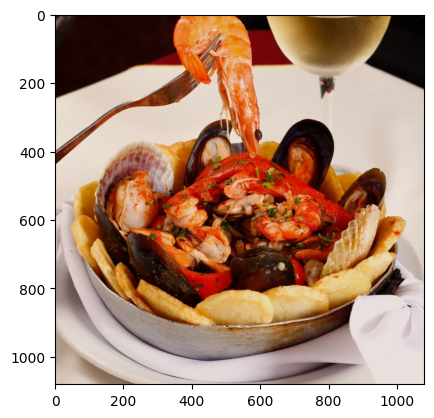

Wir lieben Tapas, du liebst Tapas & Tapas lieben es verspeist zu werden! ❤️
 
Bei uns gibt es leckere Tapas ohne Ende & dazu guten Wein! 👌😋

Ob ein Abend mit Freunden oder einfach mal nur zu zweit, bei uns seid ihr richtig 💯

📍 Wittenberger Str.76, 01309 Dresden
🌐 https://www.cantina.cafe/
📞 0351-6561 5555

#cantina_dresden #tapas #dresden #soulfood #cantina #tapasdresden #paella #cazuela #dresdenfood #wine #vino #vinothek #spanishtapas #mediterran #mediterranfood #tapaslover #tapasliebe #tapaslove
1/1 [==============================] - 0s 86ms/step
('Desconocido', 0.9994785)


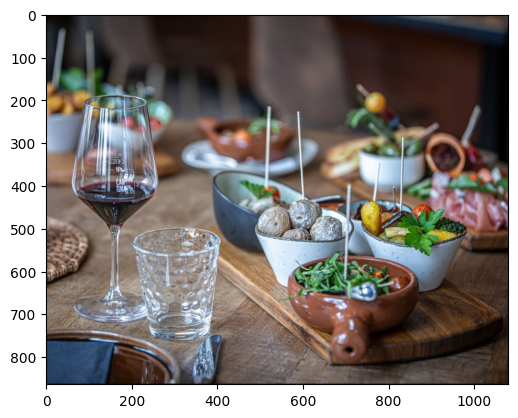

Arroz negro #arroz #paella #arroznegro #sepia #rice #paellalovers #paella
1/1 [==============================] - 0s 64ms/step
('Desconocido', 0.47953334)


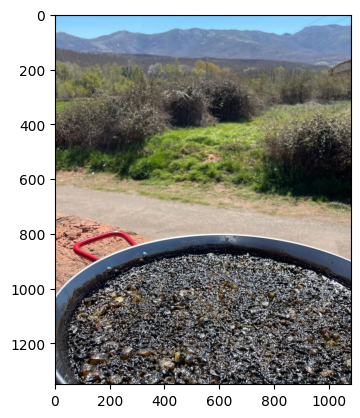

Maneras de vivir...☝🏻💥

#Madrid #Abril #primavera #cumpleaños #paella #reunion #familia #siemprefuerte #deporte #vida #vidasana #vidasaludable #fit #fitness #fitnessaddict #insta #instagood #instalike #instagram #instamoment #photooftheday #photo #photograph #selfie #like #likeforlike #moments #live #goodvibes #goodday
1/1 [==============================] - 0s 86ms/step
('Arroz con cosas', 0.9801226)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


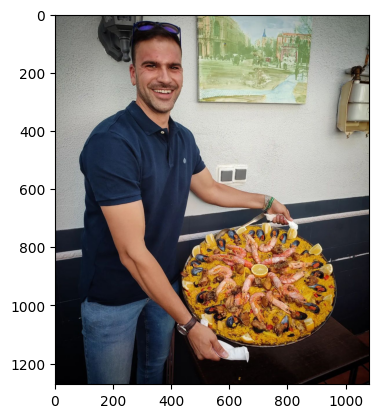

✨ ¿Qué más podemos pedir, verdad? ✨ Disfrutar del mar, del buen tiempo, de una sangría, una buena charla, ver pasar un velero... ¡Maravillosos momentos! 

#calafell #restaurante #tarragona #paseomaritimo #playa #elvelerdecalafell #mar #calafellexperience #restaurantemarinero #marisco #paella #marmediterraneo #calafellplaya
1/1 [==============================] - 0s 95ms/step
('Desconocido', 0.98037875)


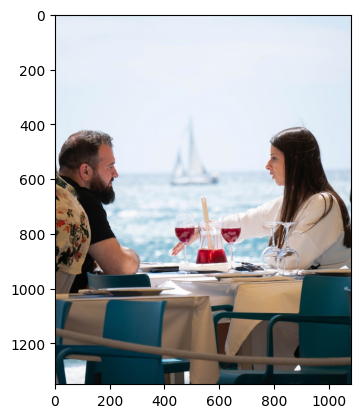

Our NEW 🇪🇸 set lunch at 📍 @_la_rambla__ starting tomorrow…
This beautiful “surf ‘n turf” paella 🥘 is sooo good!!! Chicken 🐓 + prawn 🦐 and green beans…soooo delicious !!!!

#laramblahk #laramblahongkong #paella #paellas #paella🥘 #paellalovers  #spanish #spanishfood #thefinaltable #thefinaltablenetflix #chefsofinstagram #chefslife #chefsroll #chefstable #chefsoninstagram #chefstalk #chefs_eye #chefstagram #chefsteps #chefstyle #chefslife🔪 #chefskills #chefsalert #chefstatus #chefspecial #hkfoodie #hkfoodblogger #hkfoodstagram #hkfoodlover
1/1 [==============================] - 0s 86ms/step
('Arroz con cosas', 0.92820734)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


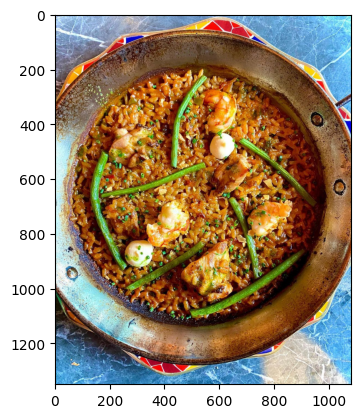

Morning, Morning my people in this Wednesday morning! Today we are starting the day with some Paella history once again.

And today is the turn of "Socarrat" 
You might be asking yourself, what the heck is socarrat?  Socarrat refers to the crispy, savory crust that forms on the the bottom layer of rice when the paella is cooked properly.  The socarrat is achieved by turning up the heat in the final minutes of cooking.
If is not Socarrat is not Paella peeps 🥘🥘🥘
.
.
.
.
.
#streetfood #islingtonmarkets #foodie #paella #food #instagood #londonfood #lunch #rice #love #lovefood #socarrat #foodstagram #chapelmarket #chef #cheflife #vegan #prawns #recipes #eat #tasty #handmade #healthyfood #seafood #cooking #veganfood #paellalovers #dairyfree #glutenfree
1/1 [==============================] - 0s 78ms/step
('Arroz con cosas', 0.60146874)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


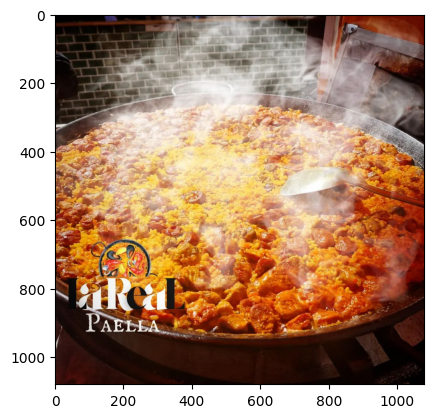

Paella Valenciana
Para el reto @flexitariantoday y @cuinaambemily con el capitán @cocina_con_allaan 

Jugando con la V W X Y Z  yo he jugado con la V 

📍arroz
📍lo que quieras para hacer un sofrito
📍judías verdes
📍pollo
📍conejo
📍caldo de pollo

-sofrio el conejo y el pollo y lo aparto 
-En la misma paella hacemos el sofrito.
-añadimos el arroz para que se sofria  un poquito y seguidamente el caldo de pollo
-rectificamos de sal 
- añadimos las judías el pollo y el conejo

Ha esperar que el arroz esté en su punto y a disfrutar !!!!! 

#flexitariantoday
#paella #fetpermí #fetacasa #hechasencasa #hechopormi #hechopormiesmejor #hechoencasa #homemadefood #thefeedfeedbaking #baking #comida #cena ##receta #recetas
1/1 [==============================] - 0s 61ms/step
('Arroz a banda', 0.77249205)


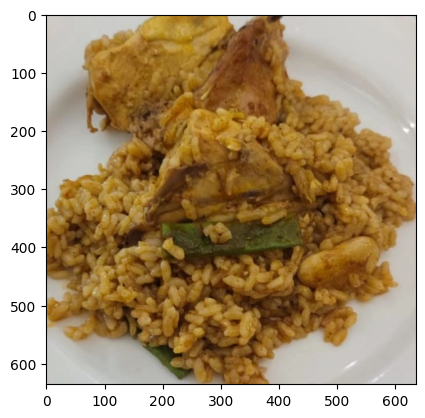

reservation@thesevenhotel.lu
www.fevi.lu
T: +352 540228
📍 Restaurant FeVi Gaudium

#tapasesch #tapas #paella #paellaesch #fideua #fideuaesch #FeviGaudium #takeaway #FeViGaudium #vegan #vegetarianfood #foodporn #food #restaurantluxembourg #spanishfood #catalanfood #yummy #croquetatime #eschsuralzette #esch2022 #eschalzette #eschbelval #veganfood #menudejour #lunchmenu #menudegustation #tastingmenu #inspiration #happy #creation
1/1 [==============================] - 0s 58ms/step
('Desconocido', 0.9908255)


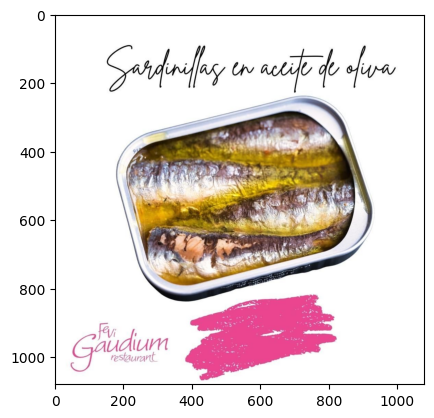

El Dorado, Sonoma
Mar 2023
American

Paella California-Style

#foodie #foodstagram #foodporn #gourmet #foodandwine #travelfood #hkfoodie #gastronomia  #lf_Sonoma_food #eldoradosonoma #instasonoma #sonoma #paella #california
1/1 [==============================] - 0s 98ms/step
('Arroz con cosas', 0.99474466)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


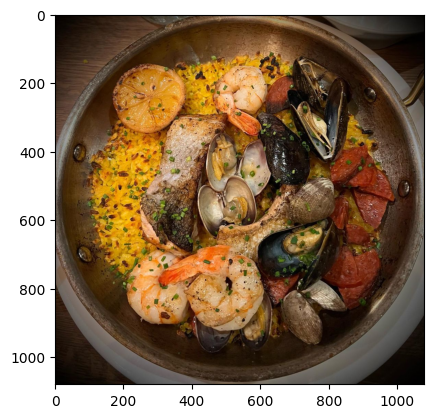

El sabor de esta paella es indescriptible. ¡Ven a probarla! 

#labarraca #restaurantemadrid #paella #granvia #spanishfood #spanishrestaurant #comidaespañola #paellalovers #paellavalenciana
1/1 [==============================] - 0s 78ms/step
('Arroz con cosas', 0.9886362)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


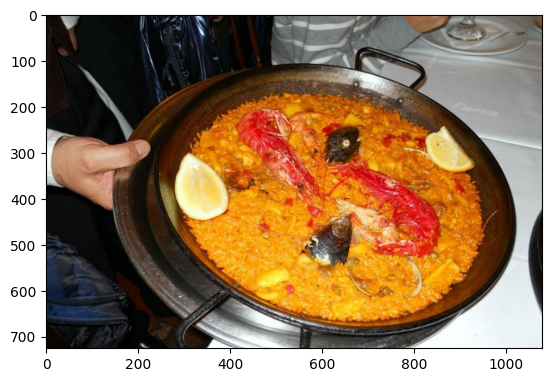

TÁ ROLANDO AGORA O ADESIVAÇO DA PAELLA DO GABRIELZINHO. 🚘

Aqui é assim... Adesivou, ganhou 2 ingressos (pista).

👉 Venha e garanta a sua entrada para a festa mais charmosa de Floripa.
📍A ação acontece hoje até às 17h, no Koxixos da Beira-Mar Norte.

#PraTodosVerem: Gabrielzinho está em pé segurando adesivo da paella com beira-mar norte de fundo.

#vereador #paelladogabrielzinho #floripa #sc #paella #beiramarnorte #bandFM
1/1 [==============================] - 0s 63ms/step
('Arroz con cosas', 0.8730188)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


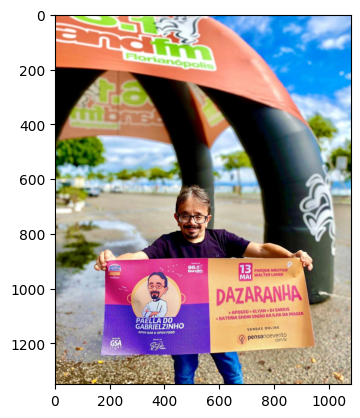

Gyoza
.
.
.
.
.
.
.
.
.
#love #photography #travelphotography #picoftheday #wander #travel #wanderlust #travelalone #instatraveler #travelgram #traveladdict #travelgoals #paella #foodgram #foodporn #foodphotography #foodstagram #hamburg #germany #momoramen #europe
1/1 [==============================] - 0s 93ms/step
('Desconocido', 0.99998844)


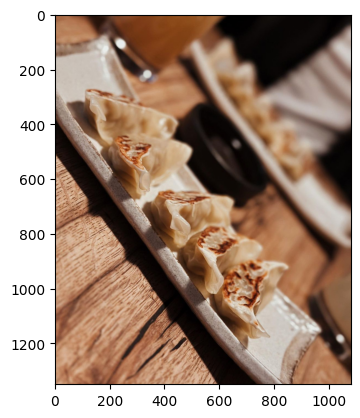

Ieri sono stato invitato a cena da una cuoca provetta Agnese ci mi ha stupito e deliziato con questa magnifica paella 🥘, peccato che però e molto restia a condividere le sue ricette 😂, ma i complimenti per questo piatto buono e perfetto sono d'obbligo #agneseasantanna 
E a voi piace la paella? fatemelo sapere nei commenti ⤵️
.
.
.
Se invece vi accontentate delle mie ricette 🤣 le trovate al link in bio ⬆️
.
.
.
.
.
#paella #laspagnaintavola #cenatraamici #foodblog #food #foodlover #foodphotografy #incuncinaperpassione #chef #cheflife #unmaredifood #fooddadio  #manama_repost
1/1 [==============================] - 0s 68ms/step
('Arroz con cosas', 0.9629858)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


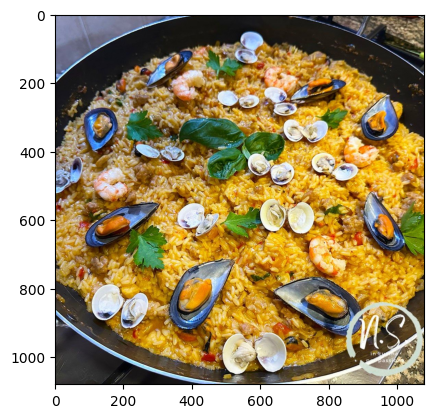

Inverness tapas night! #tapas #paella #inverness #scotland #sitework #mussels #paella
1/1 [==============================] - 0s 79ms/step
('Arroz con cosas', 0.99779934)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


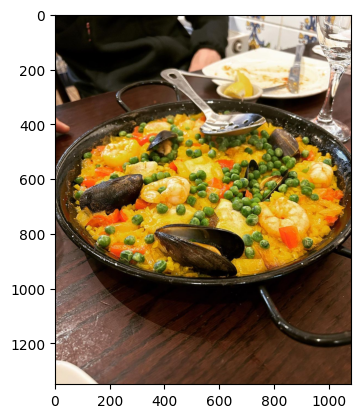

Seguimos en el camino, trabajando para volver a conseguir titulares como este y el reconocimiento de los comensales 💪 
.
#cheffenollar #lujo #luxury #paella
1/1 [==============================] - 0s 88ms/step
('Desconocido', 0.9998092)


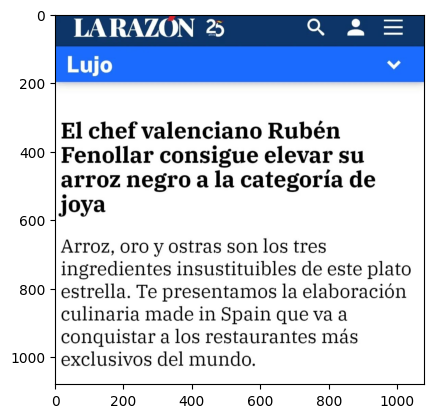

Paella – potrawa hiszpańska pochodząca z Walencji i występująca w licznych odmianach. Oparta jest przede wszystkim na ryżu z dodatkiem szafranu, podsmażanym i gotowanym na metalowej patelni z dwoma uchwytami. W zależności od odmiany, paella może ponadto zawierać kawałki np. owoców morza, mięsa królika, drobiu i różnych warzyw. 😋

#hiszpania #spain #torrevieja #costablanca #zima #winter #january
#plaża #beach #feriezimowe #winterholidays #paella #food #jedzenie #pychota
1/1 [==============================] - 0s 68ms/step
('Fideuà', 0.7102524)


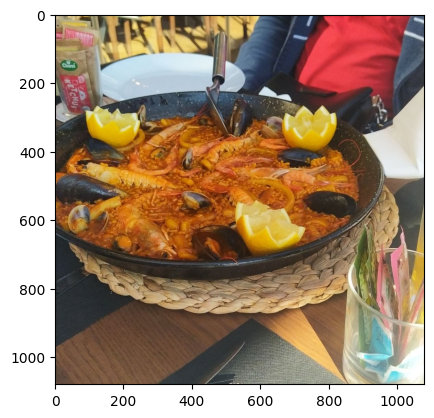

Pocas cosas disfruto más que abrir las puertas de nuestra casa para conocer nuevos amigos y estilos de vida,  aprendiendo de las experiencias compartidas junto a viajeros de todo el mundo, siempre alrededor de una mesa. #yoNosoychef
#marbella #paellaexperience  #marbellagastronomy #paella #marbellalifestyle #foodlover #cookingexperience #foodies #cookingschool #cookingclass #foodtrip #foodtravel #foodexperience
1/1 [==============================] - 0s 81ms/step
('Desconocido', 0.999881)


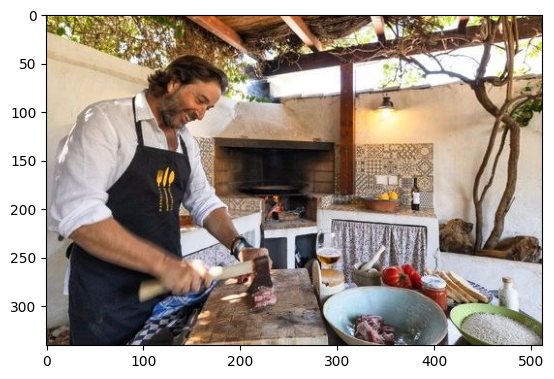

Paella 

La storia della paella è molto recente rispetto ad altri piatti tradizionali, ed è uno dei frutti delle influenze arabe sulla gastronomia valenciana.
La paella nasce come piatto semplice, povero e molto versatile, veniva infatti preparato dalle massaie che raccoglievano in questa padella il riso e tutto quello che c'era a disposizione in casa. In campagna, ad esempio, ancora oggi uno degli ingredienti principali sono le lumache di terra.
La paella da Valencia si è diffusa poi in tutta la Spagna ed oggi ogni zona prepara la sua variante. Gli ingredienti utilizzati variano quindi a seconda della località: può cambiare la carne utilizzata (coniglio, pollo, anatra), il pesce (frutti di mare, lumache), i mix di carni e di pesci utilizzati per la paella mixta, ma l’ingrediente che non può mancare è il riso.
Un ruolo fondamentale per la buona riuscita è dato dall'utilizzo dello zafferano, che conferisce il tipico colore giallo al piatto.
Ed ecco per voi la mia paella che ho voluto co

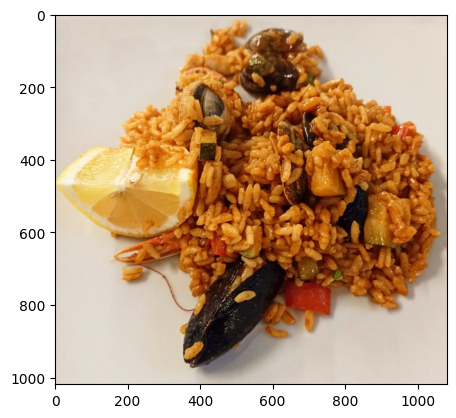

Las mejores tapas para compartir 🔥🤤sólo en #guelltapas 👏🏻
.
.
.
#bcnfoodexperience #barcelonacity #barcelonafoodexperience #barcelonafoodies #bcnfood #gastrobarna #barcelonafoodie #bcnmoltmes #bcnfoodie #elraval #tapas #bcnlovers #bcneats #elravalbarcelona #PaellaLovers #tapasbarcelona #paella #bcngourmet #bcnrestaurantes #barcelonafood #bcnrestaurant #bcnfoodieguide #barcelonafoodguide #bcn #barcelona #bcnrestaurants #bcnfoodies #tapasbar #bcntapas
1/1 [==============================] - 0s 90ms/step
('Desconocido', 0.9997408)


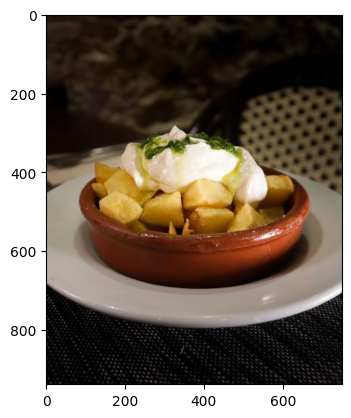

#paella #paella🥘 #riz #safran #thermomix #thermomixtm6 #thermomixfrance #thermomixfrance💚 #ideerecette #idéerepas #sansgluten #sanslait #sansglutensanslactose
1/1 [==============================] - 0s 83ms/step
('Arroz con cosas', 0.9774211)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


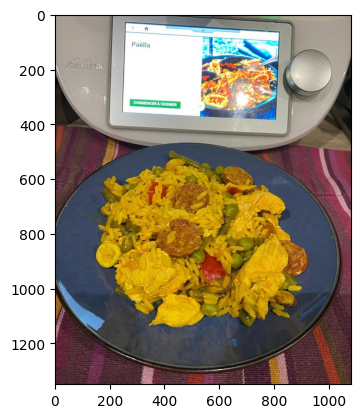

Come rendere interessante un martedì sera qualunque? 
Cenando da #Ramblas. 😍
#tapas #tapasrestaurant #spagna ##spanish #foodporn #foodporner #laspagnaacasatua #cucinatipicaspagnola #tipicospagnolo #napolifoodporn #chorizo #vino #spagnanelcuore #cucinamediterranea #paella #paelleria #paellademarisco #paellavalenciana #chef #frattamaggiore
3 g
1/1 [==============================] - 0s 52ms/step
('Desconocido', 0.9935034)


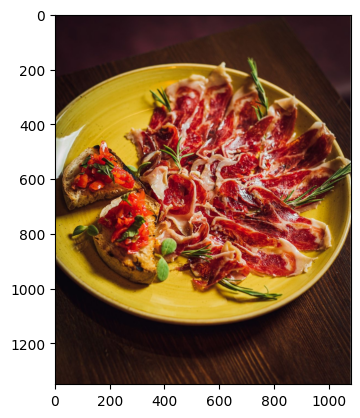

🥘 PARA ESTE FIN DE SEMANA ARROZ CON BOGAVANTE 

👩🏻‍🍳 Una receta sencilla, con buenos productos y llena de sabor ¿te apuntas?

🦞 INGREDIENTES:
Medio bogavante mediano por persona
Una taza de café de arroz por persona
Un tomate rojo y maduro
Pimiento verde
Ajo
Unas hebras de azafrán
Fumet casero de pescado, el doble de la medida de arroz
Aceite de oliva virgen extra
Sal

👩🏻‍🍳 PREPARACIÓN DE LA RECETA:
- Picamos bien el ajo y el pimiento verde y lo sofreímos en la paella con un buen chorro de aove, cuando esté listo añadimos el tomate picado, pelado y sin semillas dejándolo que se sofría bien con una pizca de sal
- En una taza ponemos un poco de fumet y unas hebras de azafrán y le damos un golpe de calor en el microondas para infusionarlo y que suelte el aroma y sabor
- Añadimos el arroz, sal al gusto y removemos para nacararlo, añadiendo el doble de la medida de arroz de fumet de pescado
- A media cocción del arroz, unos 10 minutos aproximadamente, ponemos el bogavante partido por la mit

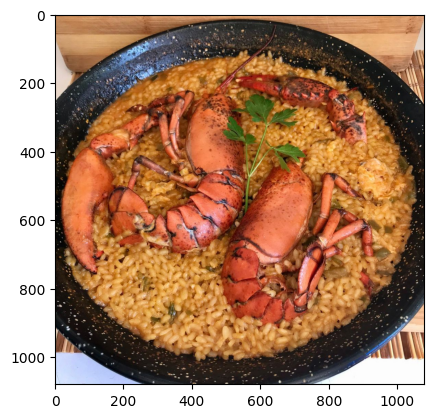

Avui a Lloret us hem preparat un Salmorejo espectacular. 
Hoy en Lloret os hemos preparado un Salmorejo espectacular. 

#totbrasa #totbrasagirona #girona #foodie #gastronomia #gironaemociona #bar #restaurant #brasa #paella #menu #esmorzar #desayuno #esmorzardeforquilla #desayunodetenedor #gironastreetphotography #total_girona #gironaemociona #ig_girona #catalunya_gastronomia #coneixcatalunyaesmorzant #recetas #receptes #lloretdemar #essenciabraseria #costabrava #braseria #salmorejo
1/1 [==============================] - 0s 71ms/step
('Desconocido', 0.86461216)


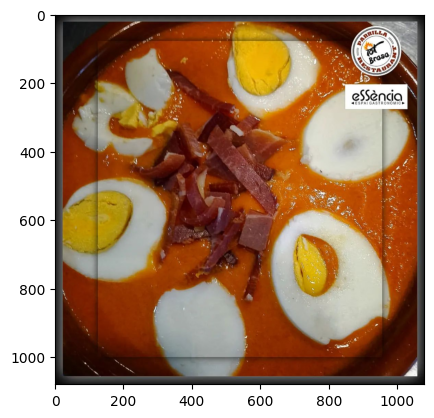

De todo corazón, ¡Muchas gracias!
Premio 'SABORS TRAYECTORIA' para el restaurante Cana Sofía en los premios de Sabors d'Eivisa 2023
#Ibizasabors2023 #RestauranteCanaSofia #chuletonIbiza #paelladelangosta  #nuevacarta2023 #CalaVedella #Ibiza #Eivissa #paella #menudomingo #arrozabanda #bullitdepeix #eatinginIbiza #solesrepsol #rojaalaplancha #pescadoalhorno #menudiarioIbiza #pescadofresco #gambasfrescas #calamarplancha #risottoIbiza #menuIbiza #menufindesemana #recomendadoguiarepsol #arroznegro #arroznegroIbiza #bodaIbiza #ibizawedding #Ibiza2023
1/1 [==============================] - 0s 57ms/step
('Desconocido', 0.9847512)


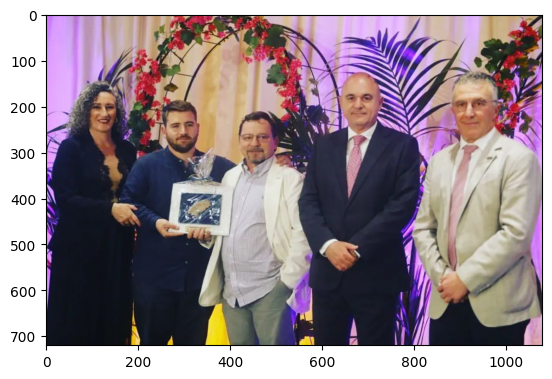

Paella Caipira - 6 pessoas
#paellacaipira #paellamarinera #paellavalenciana #paella #gastronomiaespañola #paelladotoninho #paellaindaiatuba #paellabrasil
1/1 [==============================] - 0s 85ms/step
('Arroz con cosas', 0.91997683)
Se ha comentado <Esto no es paella, esto es arroz con cosas>


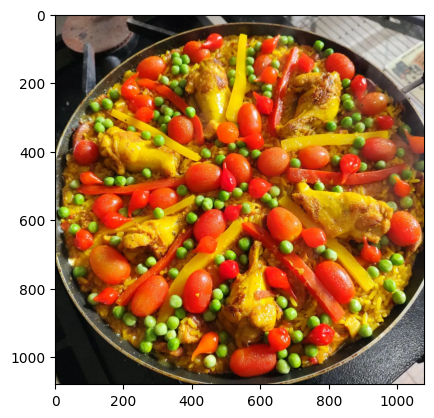

Irresistible nuestro ceviche de la casa con los más frescos frutos del mar imperdible!!! 

Irresistible our ceviche of the house with the freshest fruits of the sea not to be missed!!!

Date un gusto con sabor a mar..🦐🍤🥘🦑🐙
Treat yourself with the flavor of the sea..

Puedes reservar a través de los números
You can book through the numbers

+1 (407) 979-1941
+1 (407) 953-1738
Estamos ubicados en #kissimmee
We are located in #kissimmee

#paellasmarineras
#paellaestrella
#asopado
#paella
#instafood
#mariscos
#ceviche
#asopadodemariscos
#sabor
#frescura
#envivo
#kissimmee
#orlando
#venezolanosorlando
#venezolanosenkissimmeeyorlando
#colombianosenorlando
#ecuatorianosenorlando
#bolivianosenorlando
#paellalovers
#paellaestrella✨
#amamosloquehacemos
1/1 [==============================] - 0s 102ms/step
('Desconocido', 0.99235755)


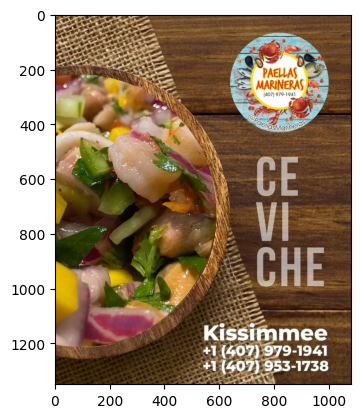

In [87]:
def isPaella(img):
    img = Image.fromarray(img)
    img = img.resize((299, 299))
    img_array = np.array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)
    predictions = model.predict(img_array)
    predicted_label = np.argmax(predictions, axis=1)
    label = predicted_label[0]
    label_str = translate_label(label)
    predicted_prob = np.max(predictions)
    
    return label_str,predicted_prob

hashtag = "paella"
medias = client.hashtag_medias_recent(hashtag, 80)

# File name where downloaded IDs will be saved
downloaded_posts_file = "downloaded_posts.txt"

if not os.path.isfile(downloaded_posts_file):
    open(downloaded_posts_file, 'w').close()

# Read previously downloaded IDs from the file
with open(downloaded_posts_file, "r") as f:
    downloaded_posts = set(f.read().splitlines())

for i, media in enumerate(medias):
    if media.id not in downloaded_posts:
        time.sleep(8)
        if media.thumbnail_url is not None:
            url = str(media.thumbnail_url)
            urllib.request.urlretrieve(url, f"{hashtag}_{i+1}.jpg")
            caption = media.caption_text if media.caption_text else ""
            print(caption)
            img = plt.imread(f"{hashtag}_{i+1}.jpg")
            plt.imshow(img)
            prediction=isPaella(img)
            tipo,_=prediction
            print(prediction)
            if tipo == "Paella":
                client.media_like(media.id)
                print("Liked the post")                
            elif tipo == "Arroz con cosas":                  
                #client.media_comment(media.id, "That is not paella, that is rice with things")
                print("Commented <This is not paella, this is rice with things>")     
            plt.show()           
            downloaded_posts.add(media.id)            
            # Write downloaded IDs to the file
            with open(downloaded_posts_file, "a") as f:
                f.write(f"{media.id}\n")

### 